In [513]:
import pickle
import pandas as pd

import nltk
from nltk.stem import WordNetLemmatizer 

In [514]:
with open("data/" + "books_df.pickle", 'rb') as to_read:
        books_df = pickle.load(to_read)
books_df        

,author,title,text,break_style,start_row_text,end_material_text,main_text
0,Hume,Enquiry Concerning Human Understanding,﻿The Project Gutenberg EBook of An Enquiry Con...,SECTION I,SECTION I,INDEX,SECTION I. OF THE DIFFERENT SPECIES OF PHILOS...
1,Whitehead,Process and Reality,Skip to main content Search UPLOAD SIGN UP | L...,CHAPTER I,CHAPTER I,Index,CHAPTER I SPECULATIVE PHILOSOPHY SECTION I ...
2,James,Pluralist Universe,﻿The Project Gutenberg EBook of A Pluralistic ...,INDEX 401,INDEX 401,INDEX TO THE LECTURES,INDEX 401^S LECTURE I THE TYPES OF PHILOSO...


In [515]:
book_titles_list = [author + "\'s\n"+ title for author, title in zip(books_df['author'].to_list(), books_df['title'].to_list() ) ]
book_titles_list

["Hume's\nEnquiry Concerning Human Understanding",
 "Whitehead's\nProcess and Reality",
 "James's\nPluralist Universe"]

In [516]:
books_df[books_df['title']=='Pluralist Universe']['main_text'].iloc[0]

' INDEX 401^S   LECTURE I  THE TYPES OF PHILOSOPHIC THINKING As these lectures are meant to be public, and so few, I have assumed all very special problems to be excluded, and some topic of general interest required. Fortunately, our age seems to be growing philosophical again--still in the ashes live the wonted fires. Oxford, long the seed-bed, for the english world, of the idealism inspired by Kant and Hegel, has recently become the nursery of a very different way of thinking. Even non-philosophers have begun to take an interest in a controversy over what is known as pluralism or humanism. It looks a little as if the ancient english empirism, so long put out of fashion here by nobler sounding germanic formulas, might be repluming itself and getting ready for a stronger flight than ever. It looks as if foundations were being sounded and examined afresh. Individuality outruns all classification, yet we insist on classifying every one we meet under some general head. As these heads usua

#### Clean up miscellanious text in James and Whitehead 

In [517]:
cleaned_text_string = books_df[books_df['title']=='Pluralist Universe']['main_text'].iloc[0].replace('INDEX 401^S', '').replace('^S   INDEX', '')
books_df.loc[books_df['title']=='Pluralist Universe','main_text'] = cleaned_text_string.replace(' nt ', ' ').replace(' bk ', ' ').replace(' nt ', ' ')


In [518]:
cleaned_text_string = books_df[books_df['title']=='Process and Reality']['main_text'].iloc[0].replace('^S   356 ^S ', '')
books_df.loc[books_df['title']=='Process and Reality','main_text'] = cleaned_text_string.replace('_', ' ').replace('^S', ' ')  


### Add newsgroups docs to the corpus

In [519]:
from sklearn.datasets import fetch_20newsgroups

In [641]:
len(twenty_train.data)

2257

In [828]:
categories = ['alt.atheism', 'soc.religion.christian','comp.graphics', 'sci.med']
#twenty_train = fetch_20newsgroups(subset='train', categories=categories, shuffle=True, random_state=42)
twenty_train = fetch_20newsgroups( shuffle=True, random_state=42)

news_g_corpus = twenty_train.data  ## get ALL the newsgroups docs
#news_g_corpus = twenty_train.data[0:50]

In [829]:
len(news_g_corpus)

11314

In [830]:
corpus_as_list = books_df.loc[:, 'main_text'].to_list() 


In [831]:
#corpus_as_list.extend(news_g_corpus)

In [832]:
corpus_as_string = ' '.join( corpus_as_list  )
# len(corpus_string)

In [833]:
from nltk.stem import *
from nltk.stem.snowball import SnowballStemmer

stemmer = SnowballStemmer('english')

def stem_string_of_text(text):
    word_list = [stemmer.stem(w) for w in text.split(' ')]
    return ' '.join(word_list)

books_df['stemmed_main_text'] = books_df['main_text'].apply(stem_string_of_text)

In [834]:
books_df

,author,title,text,break_style,start_row_text,end_material_text,main_text,stemmed_main_text
0,Hume,Enquiry Concerning Human Understanding,﻿The Project Gutenberg EBook of An Enquiry Con...,SECTION I,SECTION I,INDEX,SECTION I. OF THE DIFFERENT SPECIES OF PHILOS...,section i. of the differ speci of philosophy....
1,Whitehead,Process and Reality,Skip to main content Search UPLOAD SIGN UP | L...,CHAPTER I,CHAPTER I,Index,CHAPTER I SPECULATIVE PHILOSOPHY SECTION I ...,chapter i specul philosophi section i [4] t...
2,James,Pluralist Universe,﻿The Project Gutenberg EBook of A Pluralistic ...,INDEX 401,INDEX 401,INDEX TO THE LECTURES,LECTURE I THE TYPES OF PHILOSOPHIC THINKI...,lectur i the type of philosoph think as t...


In [835]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(stop_words='english')

In [836]:
corpus_stemmed_vec = vectorizer.fit_transform( books_df['stemmed_main_text'] )

#### Non-negative Matrix Factorization (NMF)

In [837]:
num_topics = len(book_titles_list)

In [838]:
from sklearn.decomposition import NMF
#nltk.download()

In [839]:
import numpy as np
np.set_printoptions(suppress = True, precision=6)

nmf_model = NMF(num_topics )
topics = nmf_model.fit_transform(corpus_stemmed_vec )


/opt/anaconda3/envs/metis/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:312: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(("The 'init' value, when 'init=None' and "


In [840]:
print(book_titles_list)

["Hume's\nEnquiry Concerning Human Understanding", "Whitehead's\nProcess and Reality", "James's\nPluralist Universe"]


In [841]:
topics

array([[ 0.      ,  0.001153, 36.779635],
       [58.919372,  0.      ,  0.080415],
       [ 0.00626 , 35.339952,  0.008571]])

In [842]:
topic_words = nmf_model.components_
topic_words.shape

(3, 11834)

In [843]:
number_of_word_features = 8

In [844]:
words = vectorizer.get_feature_names()
topic_indices_sorted = nmf_model.components_.argsort(axis=1)[:, -1:-(number_of_word_features+1):-1]
topic_words = [[words[e] for e in word_list] for word_list in topic_indices_sorted]
topic_words

[['actual', 'feel', 'subject', 'entiti', 'physic', 'object', 'world', 'form'],
 ['onli', 'absolut', 'thing', 'world', 'ani', 'experi', 'make', 'say'],
 ['ani', 'reason', 'natur', 'effect', 'object', 'idea', 'mind', 'human']]

In [845]:
topic_names = ['Subjective form and feeling\n of actual entities in the\nphysical world',\
               'Absolutism makes only part\nof our and animal\'s experience\n of the world',\
               'The nature of animals and \nhumans affects how their minds\nreason about objects']

assert ('subject' in topic_words[0])
assert ('onli' in topic_words[1])
assert ('natur' in topic_words[2])

In [846]:
# ALERT:  Be sure to match the topic-name ordering with what the model generates. This ordering was hard coded and 
# not properly determined algorithmically

In [847]:
topics

array([[ 0.      ,  0.001153, 36.779635],
       [58.919372,  0.      ,  0.080415],
       [ 0.00626 , 35.339952,  0.008571]])

In [848]:
(topics > 10).astype(int)

array([[0, 0, 1],
       [1, 0, 0],
       [0, 1, 0]])

In [849]:
topics_df = pd.concat([pd.DataFrame(book_titles_list, columns=['book']), pd.DataFrame(topics)], axis=1)

In [850]:
topics_df

,book,0,1,2
0,Hume's\nEnquiry Concerning Human Understanding,0.000000,0.001153,36.779635
1,Whitehead's\nProcess and Reality,58.919372,0.000000,0.080415
2,James's\nPluralist Universe,0.006260,35.339952,0.008571


In [851]:
#topics_df.columnns= ['a', 'b', 'c', 'd']
topics_df.rename(columns = dict(zip(range(num_topics), topic_names)), inplace=True)

In [852]:
topics_df.columns

Index(['book',
       'Subjective form and feeling\n of actual entities in the\nphysical world',
       'Absolutism makes only part\nof our and animal's experience\n of the world',
       'The nature of animals and \nhumans affects how their minds\nreason about objects'],
      dtype='object')

In [853]:
# # Create nicer dispaly topics
# display_columns_list = [s.replace('\n', '') for s in topics_df.columns[1:] ]
# display_columns_list 
# topics_df.set_index('book').rename(columns={topics_df.columns[1:]:display_columns_list})

In [854]:
viz_path = 'visualizations/'

In [855]:
import seaborn as sns
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = [15,3]


<AxesSubplot:>

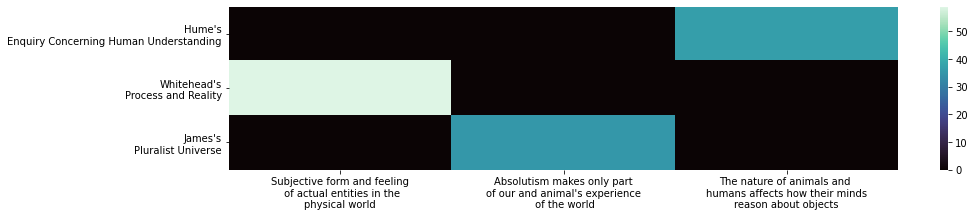

In [856]:
#plt.xlabals = topics_df.columns
#yticklabels=topics_df.iloc[:, 'book']
#xticklabels=topics_df.columns
sns.heatmap(np.array(topics_df.iloc[:,1:]), cmap='mako', xticklabels=topics_df.columns[1:], yticklabels=topics_df.loc[:, 'book'].to_list())

In [857]:
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [858]:
from io import BytesIO


def make_wordcloud(text, heading_):
    print ("There are {} words in the combination of all review.".format(len(text)))
    wordcl = WordCloud().generate(text)
    plt.figure()
    plt.imshow(wordcl, interpolation='bilinear')
    plt.title(heading_)
    plt.axis('off')
    plt.savefig(viz_path + heading_ + '.svg')
    plt.show()

    plt.close()


In [859]:

def prepare_wordcloud(book):
    book['main_text'].iloc[0]
    book_author = book['author'].iloc[0]
    book_title = book['title'].iloc[0]
    book_text = books_df.loc[books_df['title']==title_string,'main_text'].iloc[0] 
    heading = book_author + "\'s " + book_title
    return book_text, heading

There are 317202 words in the combination of all review.


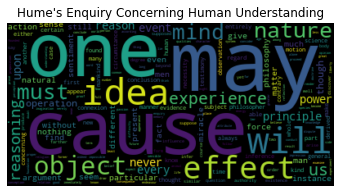

In [860]:
title_string = 'Enquiry Concerning Human Understanding'
book = books_df.loc[books_df['title']==title_string,:]

text, heading = prepare_wordcloud(book)
make_wordcloud( text, heading  )

There are 429035 words in the combination of all review.


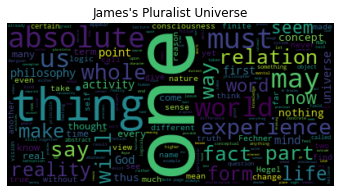

In [861]:
title_string = 'Pluralist Universe'
book = books_df.loc[books_df['title']==title_string,:]

text, heading = prepare_wordcloud(book)
make_wordcloud( text, heading  )

In [862]:
heading

"James's Pluralist Universe"

There are 986124 words in the combination of all review.


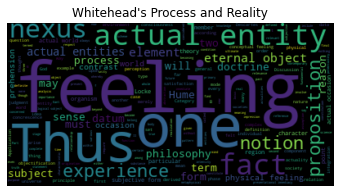

In [863]:
title_string = 'Process and Reality'
book = books_df.loc[books_df['title']==title_string,:]

text, heading = prepare_wordcloud(book)
make_wordcloud( text, heading  )

In [864]:
#books_text_only_df = pd.DataFrame(books_df['author','main_text'])
#books_text_only_df

In [865]:
books_df

,author,title,text,break_style,start_row_text,end_material_text,main_text,stemmed_main_text
0,Hume,Enquiry Concerning Human Understanding,﻿The Project Gutenberg EBook of An Enquiry Con...,SECTION I,SECTION I,INDEX,SECTION I. OF THE DIFFERENT SPECIES OF PHILOS...,section i. of the differ speci of philosophy....
1,Whitehead,Process and Reality,Skip to main content Search UPLOAD SIGN UP | L...,CHAPTER I,CHAPTER I,Index,CHAPTER I SPECULATIVE PHILOSOPHY SECTION I ...,chapter i specul philosophi section i [4] t...
2,James,Pluralist Universe,﻿The Project Gutenberg EBook of A Pluralistic ...,INDEX 401,INDEX 401,INDEX TO THE LECTURES,LECTURE I THE TYPES OF PHILOSOPHIC THINKI...,lectur i the type of philosoph think as t...


In [866]:
import spacy
import scattertext as st

In [867]:
#from scattertext.dispersion.Dispersion import Dispersion

In [868]:
nlp = spacy.load('en_core_web_sm')
#nlp = spacy.load('en')


corpus = st.CorpusFromPandas(books_df,
                             category_col='author',
                             text_col='main_text',
                             nlp=nlp).build()


In [869]:
corpus_ = corpus.get_unigram_corpus().compact(st.AssociationCompactor(2000))

In [870]:
import IPython

In [871]:
# visualize term associations
html = st.produce_scattertext_explorer(corpus_,
                                    category='Hume',
                                    category_name='Hume',
                                    not_category_name='Other',
                                    width_in_pixels=1000,
                                    minimum_term_frequency=5
                                    )
file_name = viz_path + 'Hume.html'
open(file_name, 'wb').write(html.encode('utf-8'))
IPython.display.HTML(filename=file_name)

In [872]:
# visualize term associations
html = st.produce_scattertext_explorer(corpus_,
                                    category='James',
                                    category_name='James',
                                    not_category_name='Other',
                                    width_in_pixels=1000,
                                    minimum_term_frequency=3
                                    )
file_name = viz_path + 'James.html'
open(file_name, 'wb').write(html.encode('utf-8'))
IPython.display.HTML(filename=file_name)

In [873]:
# visualize term associations
html = st.produce_scattertext_explorer(corpus_,
                                    category='Whitehead',
                                    category_name='Whitehead',
                                    not_category_name='Other',
                                    width_in_pixels=1000,
                                    minimum_term_frequency=3
                                    )
file_name = viz_path + 'Whitehead.html'
open(file_name, 'wb').write(html.encode('utf-8'))
IPython.display.HTML(filename=file_name)

## TF-IDF on all the documents

In [874]:
from nltk.tokenize import word_tokenize


In [875]:
word_list_lists = [(word_tokenize(text)) for text in corpus_as_list]
word_list_lists_alpha = [ [word.lower() for word in text if word.isalpha()] for text in word_list_lists ]
tokenized_corpus_as_list = [' '.join(word_list) for word_list in word_list_lists_alpha]

In [876]:
tokenized_corpus_as_list

['section i of the different species of philosophy moral philosophy or the science of human nature may be treated after two different manners each of which has its peculiar merit and may contribute to the entertainment instruction and reformation of mankind the one considers man chiefly as born for action and as influenced in his measures by taste and sentiment pursuing one object and avoiding another according to the value which these objects seem to possess and according to the light in which they present themselves as virtue of all objects is allowed to be the most valuable this species of philosophers paint her in the most amiable colours borrowing all helps from poetry and eloquence and treating their subject in an easy and obvious manner and such as is best fitted to please the imagination and engage the affections they select the most striking observations and instances from common life place opposite characters in a proper contrast and alluring us into the paths of virtue by th

In [878]:
stemmed_tokenized_corpus_as_list = [stem_string_of_text(text) for text in tokenized_corpus_as_list ]

In [879]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [880]:
vectorizer = TfidfVectorizer(ngram_range=(1,1), stop_words='english')

In [881]:
X_tfidf = vectorizer.fit_transform(stemmed_tokenized_corpus_as_list)

In [882]:
X_tfidf.shape

(3, 6800)

In [883]:
vectorizer.get_feature_names()

['ab',
 'abandon',
 'abat',
 'abbrevi',
 'abbé',
 'aber',
 'aberr',
 'abid',
 'abil',
 'abl',
 'ablest',
 'abnorm',
 'abolish',
 'abomin',
 'aborigin',
 'abound',
 'abov',
 'abraham',
 'abreast',
 'abridg',
 'abroad',
 'abrupt',
 'absenc',
 'absent',
 'absolut',
 'absoluten',
 'absolutist',
 'absorb',
 'absorpt',
 'abstract',
 'abstracted',
 'abstrus',
 'absurd',
 'absurdo',
 'absurdum',
 'abund',
 'abus',
 'abyss',
 'academ',
 'acceler',
 'accent',
 'accentu',
 'acceperimus',
 'accepimus',
 'accept',
 'access',
 'accid',
 'accident',
 'accompani',
 'accomplish',
 'accord',
 'account',
 'accret',
 'accru',
 'accumul',
 'accur',
 'accuraci',
 'accurs',
 'accus',
 'accustom',
 'ach',
 'achiev',
 'achill',
 'acknowledg',
 'acoust',
 'acquaint',
 'acquiesc',
 'acquir',
 'acquisit',
 'acrimoni',
 'act',
 'action',
 'activ',
 'actor',
 'actual',
 'actuat',
 'acut',
 'ad',
 'adam',
 'adapt',
 'add',
 'addendum',
 'addison',
 'addit',
 'address',
 'adduc',
 'adequ',
 'adequaci',
 'adher',
 'ad

In [884]:
nmf_model = NMF(num_topics )
topics = nmf_model.fit_transform(X_tfidf )

/opt/anaconda3/envs/metis/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:312: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(("The 'init' value, when 'init=None' and "


In [885]:
topic_words = nmf_model.components_
topic_words.shape


(3, 6800)

In [886]:
number_of_word_features = 7

In [887]:
words = vectorizer.get_feature_names()
topic_indices_sorted = nmf_model.components_.argsort(axis=1)[:, -1:-(number_of_word_features+1):-1]
topic_words = [[words[e] for e in word_list] for word_list in topic_indices_sorted]
topic_words

[['ani', 'reason', 'natur', 'object', 'caus', 'idea', 'effect'],
 ['actual', 'feel', 'entiti', 'subject', 'object', 'physic', 'nexus'],
 ['onli', 'absolut', 'thing', 'experi', 'relat', 'world', 'say']]

In [888]:
topic_names = [ 'The nature of animals and \nhumans affects how their minds\nreason about objects',\
                'Subjective form and feeling\n of a nexus of actual entities \nof the physical world',\
                'Absolutism makes only part\nof our and animal\'s experience\n of the world']

assert ('natur' in topic_words[0])
assert ('subject' in topic_words[1])
assert ('onli' in topic_words[2])

In [889]:
topics


array([[0.849514, 0.      , 0.      ],
       [0.000191, 1.064382, 0.000624],
       [0.000894, 0.000156, 1.155095]])

In [890]:
(topics > .7).astype(int)

array([[1, 0, 0],
       [0, 1, 0],
       [0, 0, 1]])

In [891]:
topics_df = pd.concat([pd.DataFrame(book_titles_list, columns=['book']), pd.DataFrame(topics)], axis=1)

In [892]:
topics_df

,book,0,1,2
0,Hume's\nEnquiry Concerning Human Understanding,0.849514,0.000000,0.000000
1,Whitehead's\nProcess and Reality,0.000191,1.064382,0.000624
2,James's\nPluralist Universe,0.000894,0.000156,1.155095


In [893]:
topics_df.rename(columns = dict(zip(range(num_topics), topic_names)), inplace=True)

In [894]:
topics_df.columns

Index(['book',
       'The nature of animals and \nhumans affects how their minds\nreason about objects',
       'Subjective form and feeling\n of a nexus of actual entities \nof the physical world',
       'Absolutism makes only part\nof our and animal's experience\n of the world'],
      dtype='object')

<AxesSubplot:>

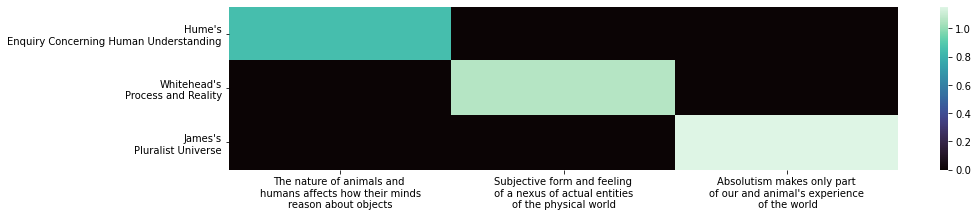

In [895]:
sns.heatmap(np.array(topics_df.iloc[:,1:]), cmap='mako', xticklabels=topics_df.columns[1:], yticklabels=topics_df.loc[:, 'book'].to_list())

### TF-IDF without stemming, in order to trace flux of that in Whitehead

In [896]:
len(corpus_as_list)

3

In [978]:
import copy
corpus_as_list_extended = copy.deepcopy(corpus_as_list)
corpus_as_list_extended.extend(news_g_corpus)
len(corpus_as_list_extended)

11317

In [979]:
#word_list_lists = [(word_tokenize(text)) for text in corpus_as_list]
word_list_lists = [(word_tokenize(text)) for text in corpus_as_list_extended]
word_list_lists_alpha = [ [word.lower() for word in text if word.isalpha()] for text in word_list_lists ]
tokenized_corpus_as_list = [' '.join(word_list) for word_list in word_list_lists_alpha]

In [899]:
vectorizer = TfidfVectorizer(ngram_range=(1,1), stop_words='english')

In [900]:
X_tfidf_unstemmed = vectorizer.fit_transform(tokenized_corpus_as_list)

In [901]:
X_tfidf_unstemmed.shape

(11317, 75858)

In [902]:
book_titles_list

["Hume's\nEnquiry Concerning Human Understanding",
 "Whitehead's\nProcess and Reality",
 "James's\nPluralist Universe"]

In [903]:
len(vectorizer.get_feature_names())

75858

In [904]:
X_tfidf_unstemmed[0,:].todense()

matrix([[0., 0., 0., ..., 0., 0., 0.]])

In [905]:
X_tfidf_unstemmed[0,:].shape

(1, 75858)

### Try with Gensim instead, since it provides a lookup dictionary that I already understand

### Try TF-IDF with sklearn instead of Gemsim

In [999]:
tokenized_corpus_as_list

['section i of the different species of philosophy moral philosophy or the science of human nature may be treated after two different manners each of which has its peculiar merit and may contribute to the entertainment instruction and reformation of mankind the one considers man chiefly as born for action and as influenced in his measures by taste and sentiment pursuing one object and avoiding another according to the value which these objects seem to possess and according to the light in which they present themselves as virtue of all objects is allowed to be the most valuable this species of philosophers paint her in the most amiable colours borrowing all helps from poetry and eloquence and treating their subject in an easy and obvious manner and such as is best fitted to please the imagination and engage the affections they select the most striking observations and instances from common life place opposite characters in a proper contrast and alluring us into the paths of virtue by th

In [1005]:
len(tokenized_corpus_as_list)

11317

In [1054]:
def from_sparse_compute_tfidf( tf_, idf_,):
    return np.array(tf_.todense()) * idf_

In [ ]:
def from_sparse_compute_tfidf_alpha( tf_, idf_, alpha_):
    tf = np.array(tf_.todense())
    return (tf*(tf/(tf**alpha))* idf_ *alpha_**(idf_-1))

In [1135]:
def from_sparse_compute_tfidf_alpha( tf_, idf_, alpha_):
    tf = np.array(tf_.todense())
    return (tf*(tf/(tf**alpha))* idf_ *alpha_**(idf_-1))

In [1214]:
tokenized_corpus_as_list

['section i of the different species of philosophy moral philosophy or the science of human nature may be treated after two different manners each of which has its peculiar merit and may contribute to the entertainment instruction and reformation of mankind the one considers man chiefly as born for action and as influenced in his measures by taste and sentiment pursuing one object and avoiding another according to the value which these objects seem to possess and according to the light in which they present themselves as virtue of all objects is allowed to be the most valuable this species of philosophers paint her in the most amiable colours borrowing all helps from poetry and eloquence and treating their subject in an easy and obvious manner and such as is best fitted to please the imagination and engage the affections they select the most striking observations and instances from common life place opposite characters in a proper contrast and alluring us into the paths of virtue by th

In [1136]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
# our corpus
#data = ['I like dog', 'I love cat', 'I interested in cat']
data = tokenized_corpus_as_list

cv = CountVectorizer(stop_words="english")

# convert text data into term-frequency matrix
data = cv.fit_transform(data)

tf_transformer    = TfidfTransformer(  use_idf=False)
# 
#tfidf_transformer = TfidfTransformer(  use_idf=True)


tf_matrix    = tf_transformer.fit_transform( data ) 
# convert term-frequency matrix into tf-idf
#tfidf_matrix = tfidf_transformer.fit_transform(data)


tfidf_transformer = TfidfTransformer(  use_idf=True)
idf_vec = tfidf_transformer.fit(data).idf_

alpha = 1.2
tfidf_alpha = from_sparse_compute_tfidf_alpha( tf_matrix, idf_vec, alpha)
tfidf_computed = from_sparse_compute_tfidf( tf_matrix, idf_vec)

# create dictionary to find a tfidf word each word
#word2tfidf = dict(zip(cv.get_feature_names(), tfidf_transformer.idf_))

<ipython-input-1135-83dfd5842222>:3: RuntimeWarning: invalid value encountered in true_divide
  return (tf*(tf/(tf**alpha))* idf_ *alpha_**(idf_-1))


In [1137]:
tfidf_alpha.shape

(11317, 75858)

In [1138]:
data

<11317x75858 sparse matrix of type '<class 'numpy.int64'>'
	with 1042688 stored elements in Compressed Sparse Row format>

In [1139]:
tfidf_alpha_df = pd.DataFrame(tfidf_alpha, columns = cv.get_feature_names())

In [1140]:
tfidf_computed_df = pd.DataFrame(tfidf_computed, columns = cv.get_feature_names())

In [1172]:
word1 = 'prehensions'
word2='concrescence'
word3='actual'
word4 = 'organism'

In [1173]:
document = 1

In [1174]:
np.set_printoptions(precision=4)

In [1175]:
print(tfidf_alpha_df.loc[document ,word1],tfidf_alpha_df.loc[document,word2], tfidf_alpha_df.loc[document ,word3],tfidf_alpha_df.loc[document,word4]) 

5.324914312495161 4.76915746882427 5.36773650305687 2.197961415725386


In [1176]:
print(tfidf_computed_df.loc[document ,word1],tfidf_computed_df.loc[document,word2], tfidf_computed_df.loc[document ,word3],tfidf_computed_df.loc[document,word4]) 

0.6406245118623161 0.558167891523602 2.1649462728026605 0.39782370389849026


In [1107]:
print(tfidf_df.loc[document ,word1],tfidf_df.loc[document,word2], tfidf_df.loc[document ,word3],tfidf_df.loc[document,word4]) 

2.0384927282956395 2.697554287067914 4.531125272377645 3.300365411741237


In [1071]:
tfidf_df.loc[1,'feeling']*word2tfidf['feeling'] 

42.85686893507014

In [976]:
tfidf_df.loc[1,'concrescence']*word2tfidf['concrescence'] 

0.9314599654119982

In [968]:
#tfidf_df.loc[1,'prehensions']

In [969]:
tfidf_df.loc[1,'prehensions']*word2tfidf['prehensions'] 

1.0690620057569524

In [912]:
tfidf_matrix.shape

(11317, 75858)

### Gensim

In [1217]:
import gensim
from gensim.parsing.preprocessing import remove_stopwords, preprocess_string

In [1218]:
philosophy_docs = [gensim.utils.simple_preprocess(gensim.parsing.preprocessing.remove_stopwords(d)) for d in tokenized_corpus_as_list ]
#philosophy_docs = [gensim.parsing.preprocessing.preprocess_string(d) for d in tokenized_corpus_as_list ]

philosophy_dict = gensim.corpora.Dictionary()
philosophy_dict

#philosophy_corpus = [philosophy_dict.doc2bow(doc, allow_update=True) for doc in philosophy_docs]
philosophy_corpus = [philosophy_dict.doc2bow(doc, allow_update=True) for doc in philosophy_docs]

In [1219]:
philosophy_docs

[['section',
  'different',
  'species',
  'philosophy',
  'moral',
  'philosophy',
  'science',
  'human',
  'nature',
  'treated',
  'different',
  'manners',
  'peculiar',
  'merit',
  'contribute',
  'entertainment',
  'instruction',
  'reformation',
  'mankind',
  'considers',
  'man',
  'chiefly',
  'born',
  'action',
  'influenced',
  'measures',
  'taste',
  'sentiment',
  'pursuing',
  'object',
  'avoiding',
  'according',
  'value',
  'objects',
  'possess',
  'according',
  'light',
  'present',
  'virtue',
  'objects',
  'allowed',
  'valuable',
  'species',
  'philosophers',
  'paint',
  'amiable',
  'colours',
  'borrowing',
  'helps',
  'poetry',
  'eloquence',
  'treating',
  'subject',
  'easy',
  'obvious',
  'manner',
  'best',
  'fitted',
  'imagination',
  'engage',
  'affections',
  'select',
  'striking',
  'observations',
  'instances',
  'common',
  'life',
  'place',
  'opposite',
  'characters',
  'proper',
  'contrast',
  'alluring',
  'paths',
  'virtue',

In [983]:
phil_doc_term_matrix = gensim.matutils.corpus2dense(philosophy_corpus, num_terms=len(philosophy_dict))

phil_tfidf = gensim.models.TfidfModel(philosophy_corpus)
phil_tfidf_matrix = gensim.matutils.corpus2dense(phil_tfidf[philosophy_corpus], num_terms=len(philosophy_dict))

In [994]:
phil_idf_matrix  = gensim.models.tfidfmodel.precompute_idfs()

TypeError: precompute_idfs() missing 3 required positional arguments: 'wglobal', 'dfs', and 'total_docs'

In [989]:
phil_doc_term_matrix[philosophy_dict.token2id[ 'actual' ], 1]

1303.0

In [990]:
phil_tfidf_matrix[philosophy_dict.token2id[ 'actual' ], 1]

0.35669464

In [993]:
gensim.models.tfidfmodel.df2idf(1, philosophy_dict.token2id[ 'actual' ], add=0.0)

6.266786540694902

In [917]:
word2tfidf['nexus'] 

8.388239508647157

In [918]:
word2tfidf['feeling'] 

5.364336358126469

In [1177]:
def semantic_intensity( token, doc_num ):
    try:
        return tfidf_alpha_df.loc[doc_num ,token]
        #return phil_tfidf_matrix[philosophy_dict.token2id[ token ], doc_num]
        #return tfidf_df.loc[doc_num,token]*word2tfidf[ token ]
    except:
        return 0
    

In [920]:
philosophy_docs

[['section',
  'different',
  'species',
  'philosophy',
  'moral',
  'philosophy',
  'science',
  'human',
  'nature',
  'treated',
  'different',
  'manners',
  'peculiar',
  'merit',
  'contribute',
  'entertainment',
  'instruction',
  'reformation',
  'mankind',
  'considers',
  'man',
  'chiefly',
  'born',
  'action',
  'influenced',
  'measures',
  'taste',
  'sentiment',
  'pursuing',
  'object',
  'avoiding',
  'according',
  'value',
  'objects',
  'possess',
  'according',
  'light',
  'present',
  'virtue',
  'objects',
  'allowed',
  'valuable',
  'species',
  'philosophers',
  'paint',
  'amiable',
  'colours',
  'borrowing',
  'helps',
  'poetry',
  'eloquence',
  'treating',
  'subject',
  'easy',
  'obvious',
  'manner',
  'best',
  'fitted',
  'imagination',
  'engage',
  'affections',
  'select',
  'striking',
  'observations',
  'instances',
  'common',
  'life',
  'place',
  'opposite',
  'characters',
  'proper',
  'contrast',
  'alluring',
  'paths',
  'virtue',

In [921]:
import seaborn as sns
from matplotlib import pyplot as plt

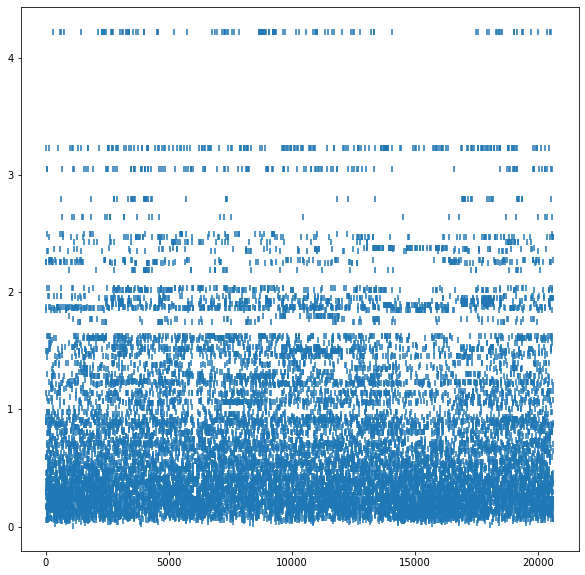

In [1178]:
doc_num = 0
philosophy_doc_intensities = [semantic_intensity(word, doc_num) for word in philosophy_docs[ doc_num ]]
#philosophy_doc_intensities = philosophy_doc_intensities[:90000]
plt.rcParams["figure.figsize"] = [10,10]
plt.scatter(range(len(philosophy_doc_intensities)), philosophy_doc_intensities, alpha=1, marker='|')
#plt.ylim(0,14000)

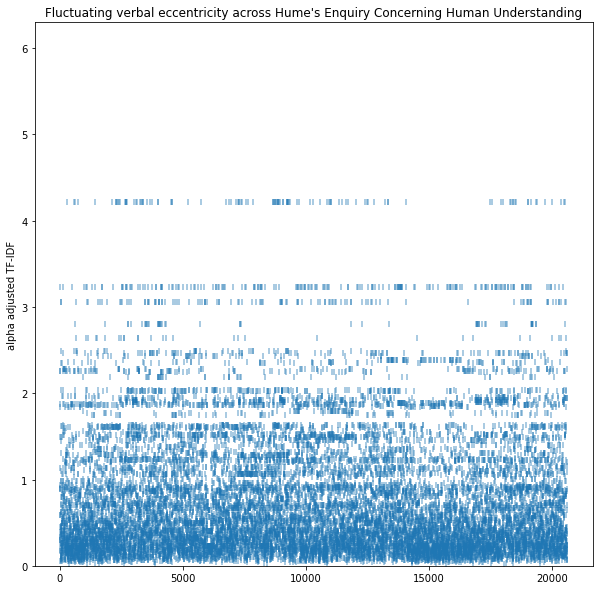

In [1370]:

doc_num = 0
philosophy_doc_intensities = [semantic_intensity(word, doc_num) for word in philosophy_docs[ doc_num ]]
#philosophy_doc_intensities = philosophy_doc_intensities[:90000]

plt.rcParams["figure.figsize"] = [10,10]
fig, ax = plt.subplots(nrows=1, ncols=1)

ax.scatter(range(len(philosophy_doc_intensities)), philosophy_doc_intensities, alpha=.5, marker='|')
#plt.yscale('log')
#plt.ylim((pow(10,0),pow(10,4)))
#plt.ylim(0, 2)
plt.ylim(0,6.3)
#plt.ylim((pow(10,0),pow(10,.8)))
plt.ylabel("alpha adjusted TF-IDF")
#ax.set_xticks(range( len(doc1_list)))
#ax.set_xticklabels(doc1_list)

heading_ = "Fluctuating verbal eccentricity across " + book_titles_list[doc_num].replace('\n', ' ')
ax.set_title( heading_ )
plt.savefig(viz_path + heading_ + '.svg')
plt.show()


In [1337]:
list_of_tuplets = list(zip(philosophy_docs[doc_num] , philosophy_doc_intensities))
words_sorted_by_intensity = sorted(list_of_tuplets, key= lambda x: x[1])
temp_df = pd.DataFrame(words_sorted_by_intensity).groupby(by=0).agg('mean').sort_values(by=1, ascending=False).head(50)
temp_df

,1
0,
connexion,4.221018
reasonings,4.219499
nature,3.233546
objects,3.055582
qualities,2.798734
enquiry,2.644701
sentiment,2.493891
reasoning,2.467368
senses,2.429436


In [1338]:
philosophy_docs[1]

['chapter',
 'speculative',
 'philosophy',
 'section',
 'course',
 'lectures',
 'designed',
 'essay',
 'speculative',
 'philosophy',
 'task',
 'define',
 'speculative',
 'defend',
 'method',
 'productive',
 'important',
 'knowledge',
 'speculative',
 'philosophy',
 'endeavour',
 'frame',
 'coherent',
 'logical',
 'necessary',
 'general',
 'ideas',
 'terms',
 'element',
 'experience',
 'interpreted',
 'notion',
 'interpretation',
 'mean',
 'conscious',
 'enjoyed',
 'perceived',
 'willed',
 'thought',
 'shall',
 'character',
 'particular',
 'instance',
 'general',
 'scheme',
 'philosophical',
 'scheme',
 'coherent',
 'logical',
 'respect',
 'interpretation',
 'applicable',
 'adequate',
 'applicable',
 'means',
 'items',
 'experience',
 'interpretable',
 'adequate',
 'means',
 'items',
 'incapable',
 'interpretation',
 'coherence',
 'employed',
 'means',
 'fundamental',
 'ideas',
 'terms',
 'scheme',
 'developed',
 'presuppose',
 'isolation',
 'meaningless',
 'requirement',
 'mean',
 'def

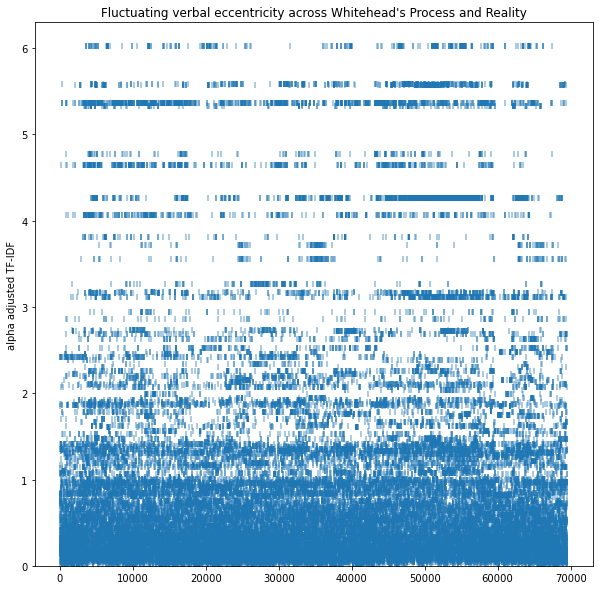

In [1369]:
doc_num=1
philosophy_doc_intensities = [semantic_intensity(word, doc_num) for word in philosophy_docs[ doc_num ]]

plt.rcParams["figure.figsize"] = [10,10]
fig, ax = plt.subplots(nrows=1, ncols=1)
#plt.yscale('log')
#plt.ylim((pow(10,0),pow(10,.8)))
plt.ylim(0, 6.3)
ax.scatter(range(len(philosophy_doc_intensities)), philosophy_doc_intensities, alpha=.5, marker='|')
plt.ylabel("alpha adjusted TF-IDF")
#ax.set_xticks(range( len(doc1_list)))
#ax.set_xticklabels(doc1_list)
heading_ = "Fluctuating verbal eccentricity across " + book_titles_list[doc_num].replace('\n', ' ')
ax.set_title( heading_ )


plt.savefig(viz_path + heading_ + '.svg')
plt.show()


In [1340]:
len(philosophy_doc_intensities)

69533

In [1341]:
window_size = 1000
x_points = range(0, len(philosophy_doc_intensities)-window_size)
len(x_points)

68533

In [1342]:

mov_avg = [np.mean(philosophy_doc_intensities[n:n+window_size]) for n in x_points]

(0.0, 3.0)

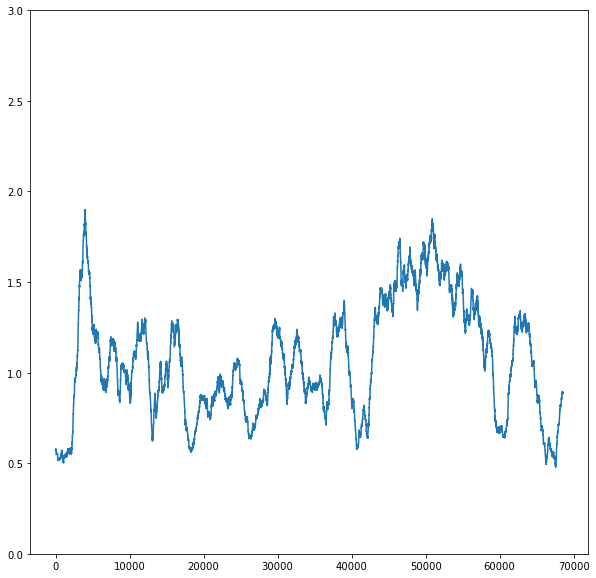

In [1371]:
sns.lineplot(x=x_points, y= mov_avg )
plt.ylim(0, 3)

In [1344]:
# #Hume
# list_of_tuplets = list(zip(philosophy_docs[0] , philosophy_doc_intensities))
# words_sorted_by_intensity = sorted(list_of_tuplets, key= lambda x: x[1])
# pd.DataFrame(words_sorted_by_intensity).groupby(by=0).agg('mean').sort_values(by=1, ascending=False).head(50)

In [1345]:
doc_num

1

In [1346]:
list_of_tuplets = list(zip(philosophy_docs[doc_num] , philosophy_doc_intensities))
words_sorted_by_intensity = sorted(list_of_tuplets, key= lambda x: x[1])
temp_df = pd.DataFrame(words_sorted_by_intensity).groupby(by=0).agg('mean').sort_values(by=1, ascending=False).head(50)
temp_df

,1
0,
nexus,6.022154
datum,5.584408
conceptual,5.571890
actual,5.367737
prehensions,5.324914
concrescence,4.769157
entity,4.646721
feeling,4.264494
feelings,4.263311


In [1347]:
search_term = 'prehension'
search_term_indices = [index for index, value in enumerate(philosophy_docs[1]) if value==search_term]

In [1348]:
search_term_indices[:10]

[3177, 3216, 3380, 3403, 3410, 3420, 3963, 4218, 4256, 4274]

In [1349]:
index = search_term_indices[-25]
the_doc_num = 1
print( philosophy_docs[the_doc_num][index-1] + ' ' + philosophy_docs[the_doc_num][index]  + ' ' + philosophy_docs[the_doc_num][index+1] ) 




negative prehension actualities


In [1350]:
philosophy_docs[the_doc_num][search_term_indices[-25] - 9: search_term_indices[-25] + 1]

['given',
 'concrescence',
 'included',
 'positively',
 'means',
 'conceptual',
 'feeling',
 'excluded',
 'negative',
 'prehension']

In [1351]:
phi_docs = philosophy_docs
[phi_docs[1][i-2]+' ' +phi_docs[1][i-1]+' ' +phi_docs[1][i] +' '+ phi_docs[1][i+1] +' '+ phi_docs[1][i+2] for i in search_term_indices]



['notions actual prehension ontological philosophical',
 'concreteness entity prehension endeavour base',
 'quota prehensions prehension reproduces general',
 'entity reproduced prehension complete actuality',
 'incomplete partiality prehension subordinate element',
 'required reason prehension respect subjective',
 'synthesis entities prehension patterned entities',
 'termed xi prehension consists factors',
 'forms type prehension xii species',
 'forms negative prehension holds datum',
 'called terms prehension feeling compared',
 'outcome fact prehension considered abstraction',
 'integrated conceptual prehension quenching appetition',
 'novel conceptual prehension especially accounted',
 'pole impurity prehension refers prehension',
 'prehension refers prehension arising integration',
 'impure mental prehension impure physical',
 'impure physical prehension conversely term',
 'impure applied prehension perfectly definite',
 'term conceptual prehension entirely neutral',
 'synthesis 

In [1352]:
excerpt = 'In any given concrescence, it may be included positively by means of a conceptual feeling; but it may be excluded by a negative prehension.'

In [1353]:
excerpt.split()

['In',
 'any',
 'given',
 'concrescence,',
 'it',
 'may',
 'be',
 'included',
 'positively',
 'by',
 'means',
 'of',
 'a',
 'conceptual',
 'feeling;',
 'but',
 'it',
 'may',
 'be',
 'excluded',
 'by',
 'a',
 'negative',
 'prehension.']

In [1354]:
#word_sequence = excerpt.split()
[semantic_intensity(re.sub(r'\W+', '', word).lower(), doc_num) for word in excerpt.split()]

[0,
 0,
 0.43812821259996754,
 4.76915746882427,
 0,
 0,
 0,
 0.35995935786770805,
 0.19518116269501445,
 0,
 0.36231088708034803,
 0,
 0,
 5.571890056300752,
 4.264494318011165,
 0,
 0,
 0,
 0,
 0.22110803850827845,
 0,
 0,
 0.5519573023724718,
 3.8116484689200547]

In [1355]:
semantic_intensity('given',1)

0.43812821259996754

In [1356]:
word_list = [re.sub(r'\W+', '', word) for word in excerpt.split()]
philosophy_excerpt_intensities = [semantic_intensity(word,1) for word in word_list]
philosophy_excerpt_intensities 

[0,
 0,
 0.43812821259996754,
 4.76915746882427,
 0,
 0,
 0,
 0.35995935786770805,
 0.19518116269501445,
 0,
 0.36231088708034803,
 0,
 0,
 5.571890056300752,
 4.264494318011165,
 0,
 0,
 0,
 0,
 0.22110803850827845,
 0,
 0,
 0.5519573023724718,
 3.8116484689200547]

In [ ]:
heading_ = "Fluctuating degrees of characteristic verbal eccentricity in a longer excerpt from Whitehead's Process & Reality"
num_x_points = len(philosophy_excerpt_intensities)
plt.rcParams["figure.figsize"] = [25,6]
plot_df = pd.DataFrame({'word': range(num_x_points), 'alpha adjusted TF-IDF': philosophy_excerpt_intensities} )

g=sns.lmplot(x='word', y='alpha adjusted TF-IDF', data=plot_df, 
         aspect=3.5,   ci=None, order =20, scatter_kws={'s':50}, line_kws={'lw':35, 'alpha':.05});
#g.set(ylim=(0, 6))
g.set(xlim=(0, num_x_points+.2))
g.set(xticks =  range(num_x_points) )
g.set(xticklabels= word_list)
g.set(xlabel= '')
plt.title(heading_)
plt.show()
g.savefig(viz_path + heading_ + '.svg')
#g.set_axis_labels('Colors', word_sequence)
#g.set(xlim=(0, 5))

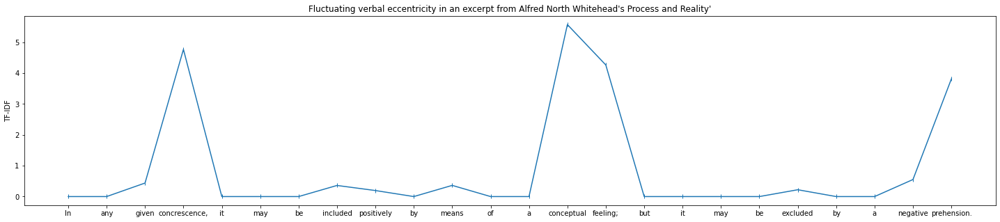

In [1358]:
len(range(len(philosophy_excerpt_intensities)))

24

In [1359]:
len(philosophy_excerpt_intensities)

24

<AxesSubplot:title={'center':"Fluctuating verbal eccentricity in an excerpt from Alfred North Whitehead's Process and Reality'"}, ylabel='TF-IDF'>

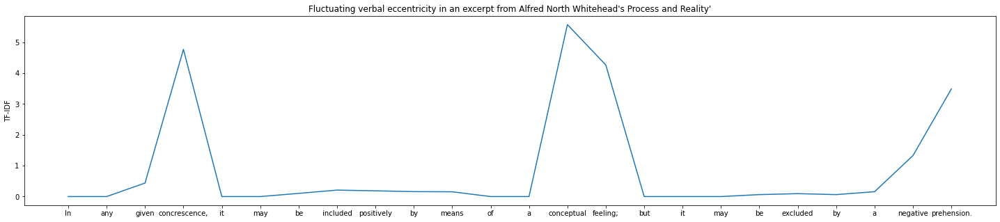

In [1360]:
import statsmodels.api as sm
lowess = sm.nonparametric.lowess
import statsmodels.api as sm
#x = np.random.uniform(low = -2*np.pi, high = 2*np.pi, size=500)
x_ = range(len(philosophy_excerpt_intensities))
#y = np.sin(x) + np.random.normal(size=len(x))
y_ = philosophy_excerpt_intensities
z = lowess(y_, x_, frac= 1./6, it=0)
w = lowess(y_, x_, frac=.19)
plt.rcParams["figure.figsize"] = [25,5]

fig, ax = plt.subplots(nrows=1, ncols=1)
plt.ylabel("TF-IDF")
ax.set_title("Fluctuating verbal eccentricity in an excerpt from Alfred North Whitehead\'s Process and Reality'")
ax.set_xticks(range( len(philosophy_excerpt_intensities)))
ax.set_xticklabels(word_sequence)

sns.lineplot(x=x_, y= w[:,1])

,word,semantic_intensity
0,0,0.000000
1,1,0.000000
2,2,0.438128
3,3,4.769157
4,4,0.000000
5,5,0.000000
6,6,0.000000
7,7,0.359959
8,8,0.195181
9,9,0.000000


ValueError: The number of FixedLocator locations (66), usually from a call to set_ticks, does not match the number of ticklabels (24).

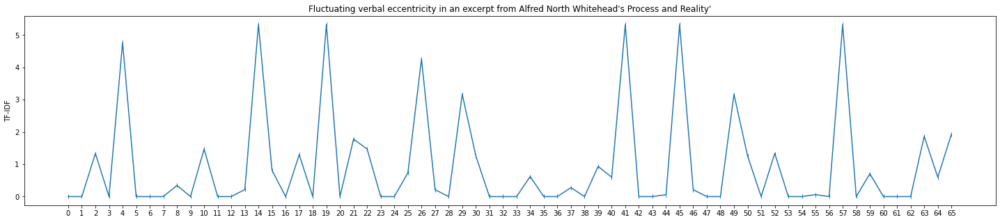

In [1560]:
import re

#word_sequence = excerpt.split()
#philosophy_excerpt_intensities = [semantic_intensity(re.sub(r'\W+', '', word).lower(), doc_num) for word in word_sequence ]
#philosophy_doc_intensities = philosophy_doc_intensities[:90000]


plt.rcParams["figure.figsize"] = [25,5]
fig, ax = plt.subplots(nrows=1, ncols=1)
plt.ylabel("TF-IDF")
ax.plot(range(len(philosophy_excerpt_intensities)), philosophy_excerpt_intensities, alpha=1, marker='|')
ax.set_title("Fluctuating verbal eccentricity in an excerpt from Alfred North Whitehead\'s Process and Reality'")
ax.set_xticks(range( len(philosophy_excerpt_intensities)))
ax.set_xticklabels(word_sequence)
plt.savefig(viz_path + 'Flux_of_semantic_intensity' + '.svg')
#plt.ylim(0,14000)


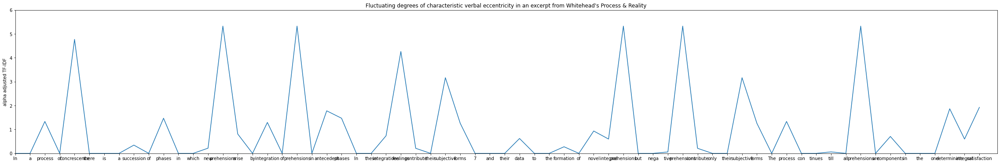

In [1548]:
heading_ = "Fluctuating degrees of characteristic verbal eccentricity in an excerpt from Whitehead's Process & Reality"
num_x_points = len(philosophy_excerpt_intensities)
plt.rcParams["figure.figsize"] = [40,6]
plot_df = pd.DataFrame({'word': range(num_x_points), 'alpha adjusted TF-IDF': philosophy_excerpt_intensities} )

#g=sns.lmplot(x='word', y='alpha adjusted TF-IDF', data=plot_df, 
#        aspect=3.5,   ci=None, order =14, scatter_kws={'s':1000}, line_kws={'lw':45, 'alpha':.05});
g=sns.lineplot(x='word', y='alpha adjusted TF-IDF', data=plot_df, 
           ci=None);

g.set(ylim=(0, 6))
g.set(xlim=(0, num_x_points+.2))
g.set(xticks =  range(num_x_points) )
#g.set(xticklabels= word_sequence)
g.set(xticklabels= word_list)
g.set(xlabel= '')
plt.title(heading_)

plt.savefig(viz_path + heading_ + '.svg')
plt.show()
#g.set_axis_labels('Colors', word_sequence)
#g.set(xlim=(0, 5))

In [1526]:
excerpt2 = '''In a process of concrescence, there is a succession of phases in 
which new prehensions arise by integration of prehensions in antecedent 
phases. In these integrations 'feelings' contribute their 'subjective forms 7 
and their 'data' to the formation of novel integral prehensions; but 'nega- 
tive prehensions' contribute only their 'subjective forms/ The process con- 
tinues till all prehensions are components in the one determinate integral 
satisfaction.'''

In [1527]:
word_list = [re.sub(r'\W+', '', word) for word in excerpt2.split()]
philosophy_excerpt_intensities = [semantic_intensity(word,1) for word in word_list]
philosophy_excerpt_intensities 

[0,
 0,
 1.3348608454543702,
 0,
 4.76915746882427,
 0,
 0,
 0,
 0.34510932013712586,
 0,
 1.4695748444613288,
 0,
 0,
 0.21706028666623392,
 5.324914312495161,
 0.8116944039220226,
 0,
 1.294246857153466,
 0,
 5.324914312495161,
 0,
 1.7798326799402913,
 1.4695748444613288,
 0,
 0,
 0.7351748898055103,
 4.263310876427876,
 0.21142801382018206,
 0,
 3.1655323942189213,
 1.25978614644351,
 0,
 0,
 0,
 0.6220430784317789,
 0,
 0,
 0.27622646961847014,
 0,
 0.9351125841360904,
 0.5989916441305339,
 5.324914312495161,
 0,
 0,
 0.05835893784259871,
 5.324914312495161,
 0.21142801382018206,
 0,
 0,
 3.1655323942189213,
 1.25978614644351,
 0,
 1.3348608454543702,
 0,
 0,
 0.060892201128139686,
 0,
 5.324914312495161,
 0,
 0.707205538286402,
 0,
 0,
 0,
 1.8656168701308284,
 0.5989916441305339,
 1.9239577402918575]

In [1529]:
len(philosophy_excerpt_intensities)

66

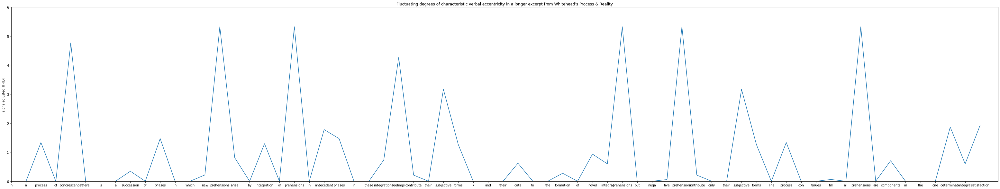

In [1556]:
heading_ = "Fluctuating degrees of characteristic verbal eccentricity in a longer excerpt from Whitehead's Process & Reality"
num_x_points = len(philosophy_excerpt_intensities)
plt.rcParams["figure.figsize"] = [55,10]
plot_df = pd.DataFrame({'word': range(num_x_points), 'alpha adjusted TF-IDF': philosophy_excerpt_intensities} )

#g=sns.lmplot(x='word', y='alpha adjusted TF-IDF', data=plot_df, 
#        aspect=3.5,   ci=None, order =14, scatter_kws={'s':1000}, line_kws={'lw':45, 'alpha':.05});
g=sns.lineplot(x='word', y='alpha adjusted TF-IDF', data=plot_df, 
           ci=None);

g.set(ylim=(0, 6))
g.set(xlim=(0, num_x_points+.2))
g.set(xticks =  range(num_x_points) )
#g.set(xticklabels= word_sequence)
g.set(xticklabels= word_list)
g.set(xlabel= '')
plt.title(heading_)

plt.savefig(viz_path + heading_ + '.svg')
plt.show()
#g.set_axis_labels('Colors', word_sequence)

### 

In [1362]:
{'x':range(len(philosophy_excerpt_intensities)), 'y': philosophy_excerpt_intensities}
tf_idf_series = pd.Series( {'x':np.array(range(len(philosophy_excerpt_intensities))), 'y': np.array(philosophy_excerpt_intensities)})
type(tf_idf_series)

pandas.core.series.Series

In [1363]:
import lowess
test_data = pd.Series({'x': np.arange(20), 'y': np.arange(20)})
#expected_lowess = np.array([test_data['x'], test_data['out']]).T
actual_lowess = lowess.lowess(test_data)
#lowess.lowess(tf_idf_series, tf_idf_series['y'], bandwidth=0.2, polynomialDegree=1)

TypeError: lowess() missing 1 required positional argument: 'y'

In [1364]:
len(word_sequence)

24

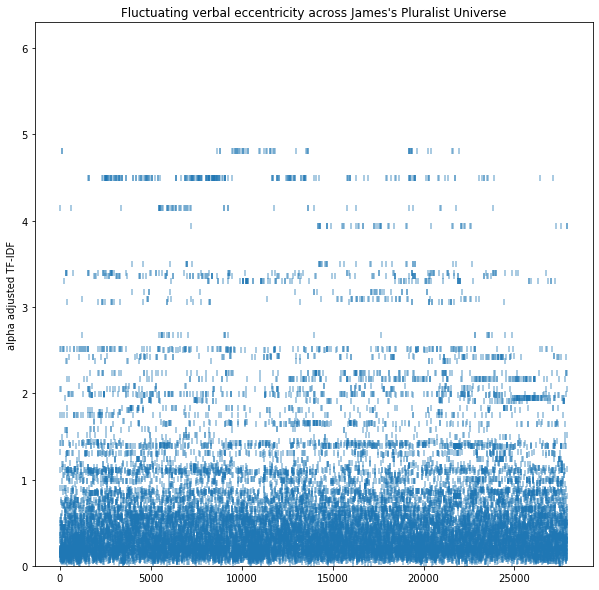

In [1368]:
doc_num=2
philosophy_doc_intensities = [semantic_intensity(word, doc_num) for word in philosophy_docs[ doc_num ]]

plt.rcParams["figure.figsize"] = [10,10]
fig, ax = plt.subplots(nrows=1, ncols=1)
#plt.yscale('log')
#plt.ylim((pow(10,0),pow(10,4)))
#plt.ylim(0, 1300)
plt.ylim(0, 6.3)


ax.scatter(range(len(philosophy_doc_intensities)), philosophy_doc_intensities, alpha=.5, marker='|')
plt.ylabel("alpha adjusted TF-IDF")
#ax.set_xticks(range( len(doc1_list)))
#ax.set_xticklabels(doc1_list)

heading_ = "Fluctuating verbal eccentricity across " + book_titles_list[doc_num].replace('\n', ' ')
ax.set_title( heading_ )


plt.savefig(viz_path + heading_ + '.svg')
plt.show()

In [1366]:
list_of_tuplets = list(zip(philosophy_docs[doc_num] , philosophy_doc_intensities))
words_sorted_by_intensity = sorted(list_of_tuplets, key= lambda x: x[1])
temp_df = pd.DataFrame(words_sorted_by_intensity).groupby(by=0).agg('mean').sort_values(by=1, ascending=False).head(50)
temp_df

,1
0,
fechner,4.804108
absolute,4.495545
hegel,4.142102
bergson,3.942059
intellectualism,3.499971
empiricism,3.395443
monistic,3.395443
finite,3.354163
consciousness,3.295099


In [1372]:
with open("/Users/joshuamailman/Desktop/Metis_Bootcamp/Metis_Bootcamp_repos/langauge_on_a_holiday/data/Process and Reality_df.pickle", 'rb') as to_read:
    Whitehead_df =  pickle.load(to_read)

In [1373]:
Whitehead_df 

,par_text
317,CHAPTER I SPECULATIVE PHILOSOPHY
318,SECTION I
319,[4] This course of lectures is designed as an...
320,Speculative Philosophy is the endeavour to fr...
321,"[5] Coherence, as here employed, means that t..."
...,...
2566,SECTION VII
2567,Thus the consequent nature of God is composed...
2568,Each actuality in the temporal world has its ...
2569,But the principle of universal relativity is ...


In [1497]:
Whitehead_content_df = Whitehead_df[Whitehead_df.loc[:,'par_text'].str.len( ) > 80]

In [1498]:
s = Whitehead_df[Whitehead_df.loc[:,'par_text'].str.contains('The function of being a means')]['par_text'].iloc[0]




In [1499]:
def aggregate_semantic_eccentricity(s, doc_num, exclude_zeros=False):
    sum_ = 0 
    count = 0
    if exclude_zeros == False:
        for w in s.split():
            sum_ += semantic_intensity(w, doc_num)
            count+=1
    else:
        for w in s.split():
            val = semantic_intensity(w, doc_num)
            if val > 0:
                sum_+=val
                count+=1
    try:
        return float(sum_)/count
    except:
        return 0
        

In [1500]:
aggregate_semantic_eccentricity(s, 1, True)

0.622329726615124

In [1501]:
Whitehead_content_df['alpha_adjust-tfidf'] = Whitehead_content_df['par_text'].apply(aggregate_semantic_eccentricity, args=(1, False))

In [1506]:
Whitehead_content_df.sort_values(by='alpha_adjust-tfidf', ascending = False)

,par_text,alpha_adjust-tfidf,alpha_adjust-tfidf_exclude_zero
1869,[377] A hybrid physical feeling originates fo...,1.255305,3.027500
476,"Prehensions of actual entities— i.e., prehens...",1.253576,2.716082
1803,[361] A simple physical feeling entertained i...,1.193030,2.783736
736,This account of presentational immediacy pres...,1.175541,2.115974
472,The term objectification refers to the partic...,1.148746,2.527241
...,...,...,...
2403,"1 Cf. my three Barbour-Page lectures, Symboli...",0.000000,0.000000
528,"3 Cf. ""Artistic Creation and Cosmic Creation,...",0.000000,0.000000
458,"(viii) Contrasts, or Modes of Synthesis of En...",0.000000,0.000000
456,"(vi) Propositions, or Matters of Fact in Pote...",0.000000,0.000000


In [1507]:
Whitehead_content_df['alpha_adjust-tfidf_exclude_zero'] = Whitehead_content_df['par_text'].apply(aggregate_semantic_eccentricity, args=(1, True))

In [1508]:
Whitehead_content_df

,par_text,alpha_adjust-tfidf,alpha_adjust-tfidf_exclude_zero
319,[4] This course of lectures is designed as an...,0.106899,0.320697
320,Speculative Philosophy is the endeavour to fr...,0.184521,0.652414
321,"[5] Coherence, as here employed, means that t...",0.260662,0.927650
322,"The term logical has its ordinary meaning, in...",0.292556,0.738356
323,It will also be noticed that this ideal of sp...,0.150488,0.417483
...,...,...,...
2564,existence. The function of being a means is n...,0.204913,0.622330
2565,Thus the universe is to be conceived as attai...,0.108704,0.516343
2567,Thus the consequent nature of God is composed...,0.309666,1.091205
2568,Each actuality in the temporal world has its ...,0.346489,0.978322


In [1509]:
Whitehead_content_df.shape[0]

1573

In [1513]:
plot_df = pd.DataFrame({'paragraph': range(Whitehead_content_df.shape[0]), 'alpha_adjusted_tf_idf': Whitehead_content_df['alpha_adjust-tfidf_exclude_zero']} )
plot_df

,paragraph,alpha_adjusted_tf_idf
319,0,0.320697
320,1,0.652414
321,2,0.927650
322,3,0.738356
323,4,0.417483
...,...,...
2564,1568,0.622330
2565,1569,0.516343
2567,1570,1.091205
2568,1571,0.978322


In [1514]:
#plot_df = pd.DataFrame({'paragraph': [1, 2, 3], 'alpha_adjusted_tf_idf': [0.1, 2.5, 1.8]})

/opt/anaconda3/envs/metis/lib/python3.8/site-packages/seaborn/regression.py:256: RankWarning: Polyfit may be poorly conditioned
  yhat = reg_func(x, y)


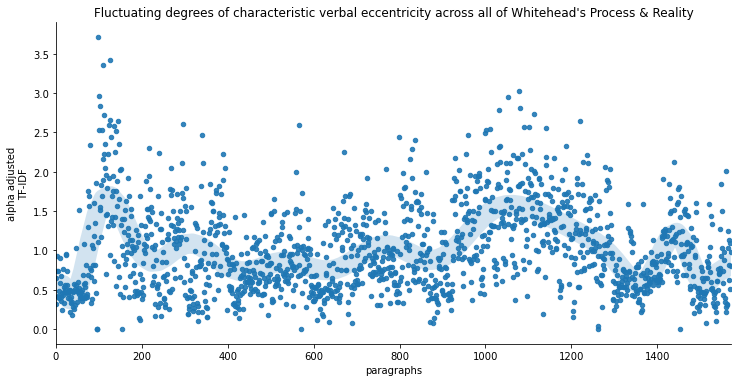

In [1515]:
heading_ = "Fluctuating degrees of characteristic verbal eccentricity across all of Whitehead's Process & Reality"
num_x_points = plot_df.shape[0]
plt.rcParams["figure.figsize"] = [25,6]

g=sns.lmplot(x='paragraph', y='alpha_adjusted_tf_idf', data=plot_df, 
         aspect=2,   ci=None, order =40, scatter_kws={'s':20, 'alpha':0.9}, line_kws={'lw':20, 'alpha':0.2})
#g.set(ylim=(0, 6))
#g.set(xlim=(0, num_x_points+.2))
#g.set(xticks =  range(num_x_points) )
#g.set(xticklabels= word_sequence)
#g.set(xlabel= '')
plt.title(heading_)

g.savefig(viz_path + heading_ + '.svg')
g.set_axis_labels( 'paragraphs', 'alpha adjusted\nTF-IDF')
#g.set(xlim=(0, 5))


In [1559]:
Whitehead_content_df.sort_values(by='alpha_adjust-tfidf', ascending=False)

,par_text,alpha_adjust-tfidf,alpha_adjust-tfidf_exclude_zero
1869,[377] A hybrid physical feeling originates fo...,1.255305,3.027500
476,"Prehensions of actual entities— i.e., prehens...",1.253576,2.716082
1803,[361] A simple physical feeling entertained i...,1.193030,2.783736
736,This account of presentational immediacy pres...,1.175541,2.115974
472,The term objectification refers to the partic...,1.148746,2.527241
...,...,...,...
2403,"1 Cf. my three Barbour-Page lectures, Symboli...",0.000000,0.000000
528,"3 Cf. ""Artistic Creation and Cosmic Creation,...",0.000000,0.000000
458,"(viii) Contrasts, or Modes of Synthesis of En...",0.000000,0.000000
456,"(vi) Propositions, or Matters of Fact in Pote...",0.000000,0.000000


In [1483]:
Whitehead_content_df.columns

Index(['par_text', 'alpha_adjust-tfidf', 'alpha_adjust-tfidf_exclude_zero'], dtype='object')

In [ ]:
Whitehead_content_df